In [1]:
import numpy as np 
import pandas as pd
import sklearn
import time
import os
import shap
import re, pip, conda
import seaborn as sns # 用于特征重要性柱状图 Seaborn默认的图形样式和调色板使得绘图更美观，无需手动调整样式
import matplotlib.pyplot as plt
from PIL import Image
from io import BytesIO
from scipy.interpolate import make_interp_spline # type: ignore
from sklearn.pipeline import Pipeline
from sklearn.metrics import roc_curve # 使用 roc_curve 函数计算 ROC 曲线的 FPR 和 TPR，并将这些数据存储为 pandas DataFrame
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_validate, KFold
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from ngboost import NGBClassifier
from sklearn.metrics import roc_auc_score, accuracy_score, f1_score, precision_score, recall_score, make_scorer
from pyswarm import pso
import random



Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


In [2]:
# 设置全局随机种子
np.random.seed(42)
random.seed(42)

In [3]:
# 读取数据
data1 = pd.read_excel(r'D:\Users\刘洋\Desktop\测试负2.xlsx')
X = data1.iloc[:, 1:12].values  # 取除最后一列之外的所有列作为特征
y = data1.iloc[:, 12].values   # 最后一列为标签

In [4]:
# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [5]:
# 数据标准化
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [6]:
# 自定义评分标准
scoring = {
    'roc_auc': 'roc_auc',
    'accuracy': make_scorer(accuracy_score),
    'f1': make_scorer(f1_score),
    'precision': make_scorer(precision_score),
    'recall': make_scorer(recall_score)
}

In [7]:
# 定义 PSO 优化过程
def pso_optimization(objective_function, param_bounds, integer_params):
    lb = [b[0] for b in param_bounds]
    ub = [b[1] for b in param_bounds]

    # 使用 PSO 进行优化
    best_params, _ = pso(objective_function, lb, ub, swarmsize=20, maxiter=10, minstep=1e-4, minfunc=1e-4)
    for i in integer_params:
        best_params[i] = int(best_params[i])

    return best_params

In [23]:
# 优化 XGBoost
def xgb_objective(params):
    params = list(params)
    for i in [0, 2, 6]:  # 对整数参数取整
        params[i] = int(params[i])
    
    # 初始化模型
    xgb_model = XGBClassifier(**dict(zip(param_names, params)), random_state=42)
    result = cross_validate(xgb_model, X_train, y_train, cv=10, scoring='roc_auc')
    return -result['test_score'].mean()

param_names = ['max_depth', 'learning_rate', 'n_estimators', 'subsample', 'reg_lambda', 'gamma', 'min_child_weight', 'colsample_bytree']
param_bounds = [(3, 10), (0.01, 0.3), (50, 300), (0.5, 1.0), (0, 10), (0, 5), (1, 10), (0.5, 1.0)]
optimal_xgb_params = pso_optimization(xgb_objective, param_bounds, [0, 2, 6])

Stopping search: maximum iterations reached --> 10


In [71]:
# 优化 LightGBM
def lgb_objective(params):
    params = list(params)
    for i in [0, 2, 5]:  # 对整数参数取整
        params[i] = int(params[i])

    # 初始化模型
    lgb_model = LGBMClassifier(**dict(zip(param_names, params)), random_state=42)
    result = cross_validate(lgb_model, X_train, y_train, cv=7, scoring='accuracy')
    return -result['test_score'].mean()

param_names = ['max_depth', 'learning_rate', 'n_estimators', 'subsample', 'reg_lambda', 'min_child_samples', 'colsample_bytree', 'reg_alpha']
param_bounds = [(3, 8), (0.01, 0.3), (50, 300), (0.5, 1.0), (0, 10), (5, 50), (0.5, 1.0), (0, 10)]
optimal_lgb_params = pso_optimization(lgb_objective, param_bounds, [0, 2, 5])

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 70, number of negative: 74
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000050 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 407
[LightGBM] [Info] Number of data points in the train set: 144, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.486111 -> initscore=-0.055570
[LightGBM] [Info] Start training from score -0.055570
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furthe

In [10]:
# %% 优化 CatBoost
def catboost_objective(params):
    params = list(params)
    for i in [0, 2, 3]:  # 对整数参数取整
        params[i] = int(params[i])

    # 初始化模型
    catboost_model = CatBoostClassifier(**dict(zip(catboost_param_names, params)), random_seed=42, verbose=0)
    result = cross_validate(catboost_model, X_train, y_train, cv=6, scoring='f1')
    return -result['test_score'].mean()

catboost_param_names = ['depth', 'learning_rate', 'n_estimators', 'od_wait', 'l2_leaf_reg', 'bagging_temperature', 'colsample_bylevel']
catboost_param_bounds = [(1, 15), (0.01, 0.1), (50, 500), (10, 100), (1, 10), (0, 1), (0.5, 1.0)]
optimal_cat_params = pso_optimization(catboost_objective, catboost_param_bounds, [0, 2, 3])

Stopping search: maximum iterations reached --> 10


In [61]:
# 优化 NGBoost
def ngb_objective(params):
    params = list(params)
    for i in [0, 3]:  # 对整数参数取整
        params[i] = int(params[i])  

        

    # 初始化模型
    ngb_model = NGBClassifier(**dict(zip(param_names, params)), random_state=42, verbose=0)
    result = cross_validate(ngb_model, X_train, y_train, cv=3, scoring='precision')
    return -result['test_score'].mean()

param_names = ['n_estimators', 'learning_rate', 'minibatch_frac', 'natural_gradient']
param_bounds = [(50, 300), (0.01, 0.1), (0.7, 1.0), (0, 1)]
optimal_ngb_params = pso_optimization(ngb_objective, param_bounds, [0, 3])

Stopping search: maximum iterations reached --> 10


In [81]:
# 汇总最佳参数
optimal_params = {
    "XGBoost": optimal_xgb_params,
    "LGBM": optimal_lgb_params,
    "CatBoost": optimal_cat_params,
    "NGBoost": optimal_ngb_params
}

In [82]:
# 将最优参数输出到桌面的 Excel 文件
output_file_path =  r"D:/Users/刘洋/Desktop/PSO最优参数3.xlsx"
# 创建数据字典，用于生成 DataFrame
data = {'Model': [], 'Parameter': [], 'Value': []}

# 定义每个模型的参数名称列表
xgb_param_names = ['max_depth', 'learning_rate', 'n_estimators', 'subsample', 'reg_lambda', 'gamma', 'min_child_weight', 'colsample_bytree']
lgb_param_names = ['max_depth', 'learning_rate', 'n_estimators', 'subsample', 'reg_lambda', 'min_child_samples', 'colsample_bytree', 'reg_alpha']
catboost_param_names = ['depth', 'learning_rate', 'n_estimators', 'od_wait', 'l2_leaf_reg', 'bagging_temperature', 'colsample_bylevel']
ngb_param_names = ['n_estimators', 'learning_rate', 'minibatch_frac', 'natural_gradient']

# 使用模型名称作为键对应不同的参数名称列表
model_param_names = {
    "XGBoost": xgb_param_names,
    "LGBM": lgb_param_names,
    "CatBoost": catboost_param_names,
    "NGBoost": ngb_param_names
}

for model_name, params in optimal_params.items():
    # 获取对应模型的参数名称列表
    param_names = model_param_names[model_name]
    # 将 numpy 数组转换为字典
    params_dict = dict(zip(param_names, params))
    
    for param_name, param_value in params_dict.items():
        data['Model'].append(model_name)
        data['Parameter'].append(param_name)
        if isinstance(param_value, float):
            data['Value'].append(round(param_value, 3))
        else:
            data['Value'].append(param_value)

# 将数据保存为 Excel 文件
df = pd.DataFrame(data)
with pd.ExcelWriter(output_file_path, engine='openpyxl') as writer:
    df.to_excel(writer, index=False, sheet_name='Optimal Hyperparameters')
print("Optimal hyperparameters have been saved to", output_file_path)

Optimal hyperparameters have been saved to D:/Users/刘洋/Desktop/PSO最优参数3.xlsx


In [83]:
# 确保将整数参数转换为正确的类型
def convert_params_to_int(params, int_params):
    for param in int_params:
        if param in params:
            params[param] = int(params[param])
    return params

# 针对各个模型的整数参数进行处理
xgb_params = convert_params_to_int(dict(zip(xgb_param_names, optimal_params["XGBoost"])), ['max_depth', 'n_estimators', 'min_child_weight'])
lgb_params = convert_params_to_int(dict(zip(lgb_param_names, optimal_params["LGBM"])), ['max_depth', 'n_estimators', 'min_child_samples'])
catboost_params = convert_params_to_int(dict(zip(catboost_param_names, optimal_params["CatBoost"])), ['depth', 'n_estimators', 'od_wait'])
ngb_params = convert_params_to_int(dict(zip(ngb_param_names, optimal_params["NGBoost"])), ['n_estimators'])

# 使用优化后的参数初始化模型
models = {
    "XGBoost": XGBClassifier(**xgb_params, use_label_encoder=False, eval_metric='logloss'),
    "LGBM": LGBMClassifier(**lgb_params),
    "CatBoost": CatBoostClassifier(**catboost_params, verbose=0),
    "NGBoost": NGBClassifier(**ngb_params)
    }

In [84]:
# 评估函数
def evaluate_model(model, X_train, y_train, X_test, y_test, cv):
    result = cross_validate(model, X_train, y_train, cv=cv, scoring=scoring
                            , return_train_score=True
                            , verbose=False
                            )
    metrics = {
        "train": {
            "ROC-AUC": result['train_roc_auc'].mean(),
            "ACC": result['train_accuracy'].mean(),
            "F1": result['train_f1'].mean(),
            "Precision": result['train_precision'].mean(),
            "Recall": result['train_recall'].mean()
        },
        "test": {
            "ROC-AUC": roc_auc_score(y_test, model.predict_proba(X_test)[:, 1]),
            "ACC": accuracy_score(y_test, model.predict(X_test)),
            "F1": f1_score(y_test, model.predict(X_test)),
            "Precision": precision_score(y_test, model.predict(X_test)),
            "Recall": recall_score(y_test, model.predict(X_test))
        }
    }
    return metrics

In [85]:
# 交叉验证并评估优化后的模型
results = {}
cv = KFold(n_splits=10, shuffle=True, random_state=1412)
for name, model in models.items():
    start = time.time()
    model.fit(X_train, y_train)
    metrics = evaluate_model(model, X_train, y_train, X_test, y_test, cv)
    end = time.time() - start
    metrics["time"] = end
    results[name] = metrics

[LightGBM] [Info] Number of positive: 82, number of negative: 87
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000056 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 477
[LightGBM] [Info] Number of data points in the train set: 169, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.485207 -> initscore=-0.059189
[LightGBM] [Info] Start training from score -0.059189
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 137, in __call__
    score = scorer._score(
            ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 345, in _score
    y_pred = method_caller(
             ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 87, in _cached_call
    result, _ = _get_response_values(
                ^^^^^^^^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\utils\_response.py", line 231, in _get_response_values
    raise ValueError(
ValueError: NGBClassifier should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.

Scoring failed. The sco

[iter 0] loss=0.6898 val_loss=0.0000 scale=8.0000 norm=3.9811
[iter 100] loss=0.1234 val_loss=0.0000 scale=16.0000 norm=1.7907


Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 137, in __call__
    score = scorer._score(
            ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 345, in _score
    y_pred = method_caller(
             ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 87, in _cached_call
    result, _ = _get_response_values(
                ^^^^^^^^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\utils\_response.py", line 231, in _get_response_values
    raise ValueError(
ValueError: NGBClassifier should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.

Scoring failed. The sco

[iter 0] loss=0.6939 val_loss=0.0000 scale=16.0000 norm=8.0031
[iter 100] loss=0.1046 val_loss=0.0000 scale=32.0000 norm=3.0823


Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 137, in __call__
    score = scorer._score(
            ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 345, in _score
    y_pred = method_caller(
             ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 87, in _cached_call
    result, _ = _get_response_values(
                ^^^^^^^^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\utils\_response.py", line 231, in _get_response_values
    raise ValueError(
ValueError: NGBClassifier should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.

Scoring failed. The sco

[iter 0] loss=0.6914 val_loss=0.0000 scale=16.0000 norm=7.9749
[iter 100] loss=0.1184 val_loss=0.0000 scale=32.0000 norm=3.4569


Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 137, in __call__
    score = scorer._score(
            ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 345, in _score
    y_pred = method_caller(
             ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 87, in _cached_call
    result, _ = _get_response_values(
                ^^^^^^^^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\utils\_response.py", line 231, in _get_response_values
    raise ValueError(
ValueError: NGBClassifier should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.

Scoring failed. The sco

[iter 0] loss=0.6931 val_loss=0.0000 scale=16.0000 norm=7.9969
[iter 100] loss=0.1251 val_loss=0.0000 scale=16.0000 norm=1.8167


Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 137, in __call__
    score = scorer._score(
            ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 345, in _score
    y_pred = method_caller(
             ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 87, in _cached_call
    result, _ = _get_response_values(
                ^^^^^^^^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\utils\_response.py", line 231, in _get_response_values
    raise ValueError(
ValueError: NGBClassifier should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.

Scoring failed. The sco

[iter 0] loss=0.6931 val_loss=0.0000 scale=16.0000 norm=8.0000
[iter 100] loss=0.1250 val_loss=0.0000 scale=16.0000 norm=1.8145


Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 137, in __call__
    score = scorer._score(
            ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 345, in _score
    y_pred = method_caller(
             ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 87, in _cached_call
    result, _ = _get_response_values(
                ^^^^^^^^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\utils\_response.py", line 231, in _get_response_values
    raise ValueError(
ValueError: NGBClassifier should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.

Scoring failed. The sco

[iter 0] loss=0.6939 val_loss=0.0000 scale=16.0000 norm=8.0031
[iter 100] loss=0.1136 val_loss=0.0000 scale=64.0000 norm=6.6392


Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 137, in __call__
    score = scorer._score(
            ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 345, in _score
    y_pred = method_caller(
             ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 87, in _cached_call
    result, _ = _get_response_values(
                ^^^^^^^^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\utils\_response.py", line 231, in _get_response_values
    raise ValueError(
ValueError: NGBClassifier should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.

Scoring failed. The sco

[iter 0] loss=0.6935 val_loss=0.0000 scale=16.0000 norm=8.0000
[iter 100] loss=0.0802 val_loss=0.0000 scale=32.0000 norm=2.3915


Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 137, in __call__
    score = scorer._score(
            ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 345, in _score
    y_pred = method_caller(
             ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 87, in _cached_call
    result, _ = _get_response_values(
                ^^^^^^^^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\utils\_response.py", line 231, in _get_response_values
    raise ValueError(
ValueError: NGBClassifier should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.

Scoring failed. The sco

[iter 0] loss=0.6943 val_loss=0.0000 scale=16.0000 norm=8.0063
[iter 100] loss=0.1173 val_loss=0.0000 scale=64.0000 norm=6.8414


Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 137, in __call__
    score = scorer._score(
            ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 345, in _score
    y_pred = method_caller(
             ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 87, in _cached_call
    result, _ = _get_response_values(
                ^^^^^^^^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\utils\_response.py", line 231, in _get_response_values
    raise ValueError(
ValueError: NGBClassifier should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.

Scoring failed. The sco

[iter 0] loss=0.6920 val_loss=0.0000 scale=16.0000 norm=7.9864
[iter 100] loss=0.0945 val_loss=0.0000 scale=32.0000 norm=2.7780


Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 137, in __call__
    score = scorer._score(
            ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 345, in _score
    y_pred = method_caller(
             ^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 87, in _cached_call
    result, _ = _get_response_values(
                ^^^^^^^^^^^^^^^^^^^^^
  File "e:\ProgramData\anaconda3\Lib\site-packages\sklearn\utils\_response.py", line 231, in _get_response_values
    raise ValueError(
ValueError: NGBClassifier should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.

Scoring failed. The sco

In [86]:
# 打印结果
for name, metrics in results.items():
    print(f"Model: {name}")
    print(f"Training time: {metrics['time']:.3f} s")
    for phase in ["train", "test"]:
        print(f"{phase.capitalize()} scores:")
        for metric, score in metrics[phase].items():
            print(f"  {metric}: {score:.3f}")
    print()

Model: XGBoost
Training time: 0.416 s
Train scores:
  ROC-AUC: 0.992
  ACC: 0.945
  F1: 0.945
  Precision: 0.920
  Recall: 0.973
Test scores:
  ROC-AUC: 0.871
  ACC: 0.837
  F1: 0.851
  Precision: 0.870
  Recall: 0.833

Model: LGBM
Training time: 0.249 s
Train scores:
  ROC-AUC: 0.909
  ACC: 0.816
  F1: 0.824
  Precision: 0.769
  Recall: 0.888
Test scores:
  ROC-AUC: 0.879
  ACC: 0.814
  F1: 0.840
  Precision: 0.808
  Recall: 0.875

Model: CatBoost
Training time: 5.672 s
Train scores:
  ROC-AUC: 0.966
  ACC: 0.827
  F1: 0.833
  Precision: 0.784
  Recall: 0.890
Test scores:
  ROC-AUC: 0.888
  ACC: 0.837
  F1: 0.863
  Precision: 0.815
  Recall: 0.917

Model: NGBoost
Training time: 2.565 s
Train scores:
  ROC-AUC: nan
  ACC: 1.000
  F1: 1.000
  Precision: 1.000
  Recall: 1.000
Test scores:
  ROC-AUC: 0.893
  ACC: 0.860
  F1: 0.875
  Precision: 0.875
  Recall: 0.875



In [87]:
# 将结果保存到指定位置的表格中
rows = []
for name, metrics in results.items():
    for phase in ["train", "test"]:
        row = {
            'Model': name,
            'Phase': phase,
            'Training Time (s)': metrics['time'] if phase == 'train' else None
        }
        for metric, score in metrics[phase].items():
            row[metric] = score
        rows.append(row)

# 创建 DataFrame
df = pd.DataFrame(rows)

# 保存到 Excel 文件
output_path = r'D:\Users\刘洋\Desktop\PSO精度3.xlsx'
df.to_excel(output_path, index=False)

print(f"Results have been saved to {output_path}")

Results have been saved to D:\Users\刘洋\Desktop\PSO精度3.xlsx


In [88]:
# 绘制所有模型的ROC曲线
plt.figure(figsize=(10, 8))

for name, model in models.items():
    y_pred_proba = model.predict_proba(X_test)[:, 1]
    fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
    plt.plot(fpr, tpr, label=f'PSO-{name} (AUC = {roc_auc_score(y_test, y_pred_proba):.3f})')

# 添加图例和图形的标签
plt.plot([0, 1], [0, 1], 'k--',linewidth=1)  # 参考线：随机分类器的ROC曲线
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for All Models')
plt.legend(loc='lower right')
plt.grid(True, linestyle='--', alpha=0.6)
plt.savefig(r'D:\Users\刘洋\Desktop\PSO_ROC3.png')
plt.close()  # 关闭图像以确保保存后不会影响后续图形的显示

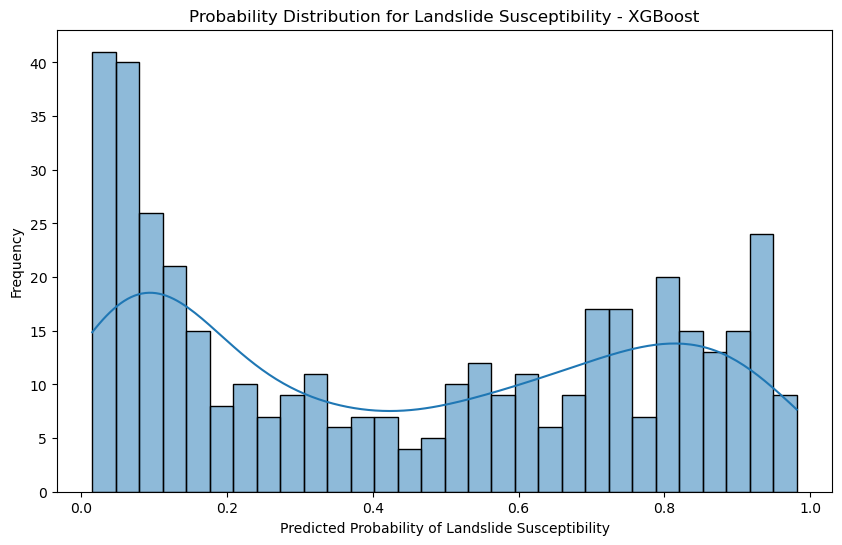

Probability Statistics for XGBoost Model:
  Mean: 0.446
  Standard Deviation: 0.329
  Min: 0.015
  Max: 0.982



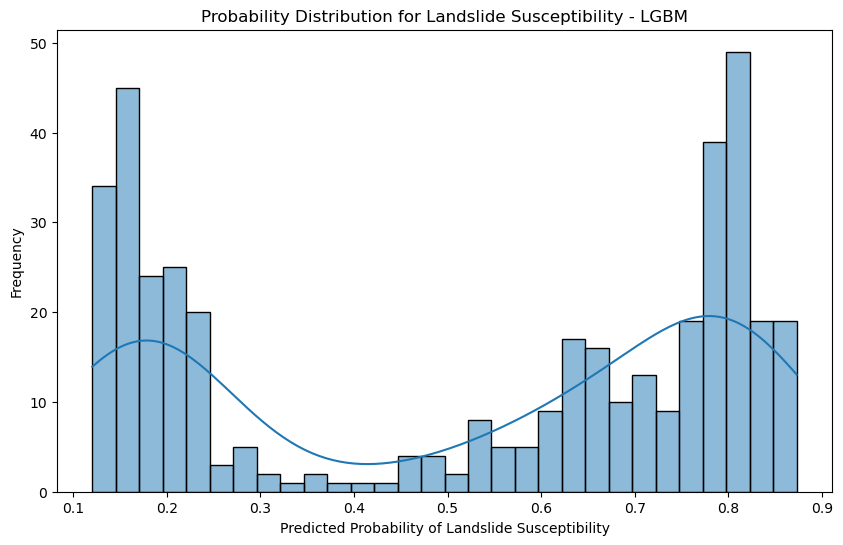

Probability Statistics for LGBM Model:
  Mean: 0.516
  Standard Deviation: 0.281
  Min: 0.120
  Max: 0.873



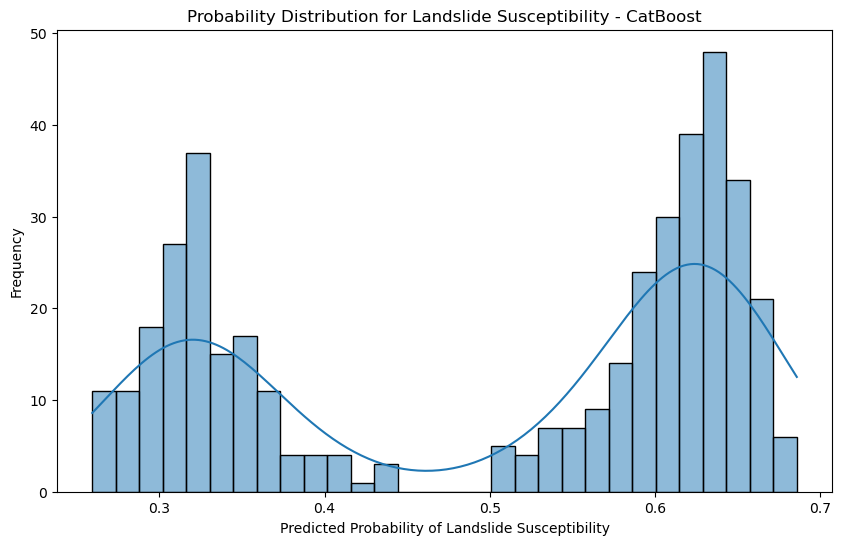

Probability Statistics for CatBoost Model:
  Mean: 0.501
  Standard Deviation: 0.147
  Min: 0.259
  Max: 0.686



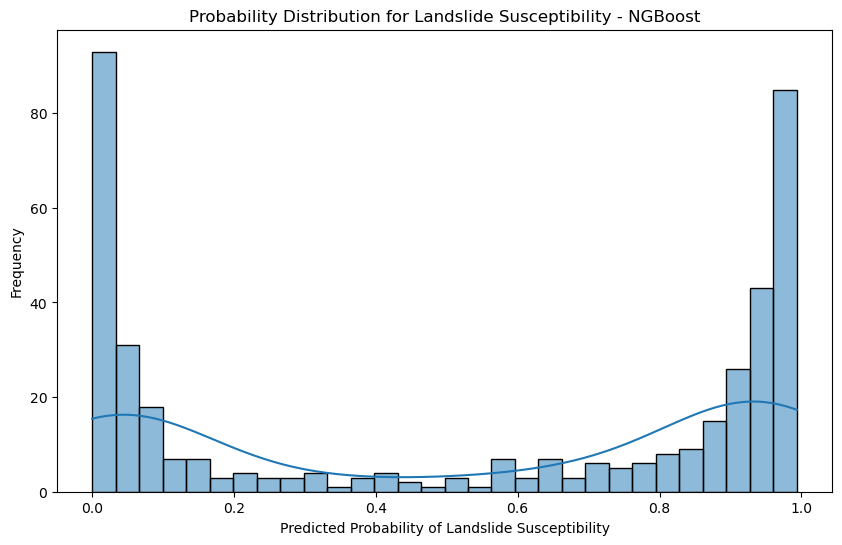

Probability Statistics for NGBoost Model:
  Mean: 0.527
  Standard Deviation: 0.417
  Min: 0.001
  Max: 0.993

Combined probability predictions have been saved to D:\Users\刘洋\Desktop\PSO3.csv


In [89]:
# 读取研究区数据
all_data = pd.read_excel(r'D:\Users\刘洋\Desktop\无坐标.xlsx')
X_all = all_data.iloc[:, 1:12].values  # 第2到12列为特征值，共计11列

# 数据标准化
scaler_all = StandardScaler()
X_all = scaler_all.fit_transform(X_all)

# 初始化用于保存所有模型预测概率的 DataFrame
probabilities_df = pd.DataFrame(index=all_data.index)

# 对研究区数据进行概率预测
for name, model in models.items():
    # 使用之前训练好的模型对研究区数据进行预测
    try:
        y_prob_all = model.predict_proba(X_all)[:, 1]  # 获取研究区数据属于“正例”（滑坡易发）的概率
    except AttributeError:
        # 如果模型未训练，进行训练（使用训练集数据）
        data1 = pd.read_excel(r'D:\Users\刘洋\Desktop\测试负2.xlsx', index_col=0)
        X = data1.iloc[:, 0:-1].values  # 取除最后一列之外的所有列作为特征
        y = data1.iloc[:, -1].values  # 最后一列为标签
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)
        model.fit(X_train, y_train)
        y_prob_all = model.predict_proba(X_all)[:, 1]
    
    # 将预测概率添加到 DataFrame 中
    probabilities_df[name] = y_prob_all
    
    # 绘制研究区数据的概率分布
    plt.figure(figsize=(10, 6))
    sns.histplot(y_prob_all, kde=True, bins=30)
    plt.title(f'Probability Distribution for Landslide Susceptibility - {name}')
    plt.xlabel('Predicted Probability of Landslide Susceptibility')
    plt.ylabel('Frequency')
    plt.show()

    # 输出概率预测的基本统计信息
    print(f"Probability Statistics for {name} Model:")
    print(f"  Mean: {np.mean(y_prob_all):.3f}")
    print(f"  Standard Deviation: {np.std(y_prob_all):.3f}")
    print(f"  Min: {np.min(y_prob_all):.3f}")
    print(f"  Max: {np.max(y_prob_all):.3f}")
    print()

# 将所有模型的概率预测结果输出到 Excel 文件
output_path = r'D:\Users\刘洋\Desktop\PSO3.csv'
probabilities_df.to_csv(output_path)
print(f"Combined probability predictions have been saved to {output_path}")

In [90]:
# %% SHAP 解释
# 确保特征名称正确
feature_names = all_data.columns[1:12]  # 第2到12列为特征名称

# 对每个模型进行 SHAP 解释
for name, model in models.items():
    print(f"Generating SHAP explanations for model: {name}")
    
    # 使用 TreeExplainer 对树模型（XGBoost、LGBM、CatBoost）进行解释
    if name in ["XGBoost", "LGBM", "CatBoost"]:
        explainer = shap.TreeExplainer(model)
        shap_values = explainer.shap_values(X_all)

        # 绘制 SHAP 总结图（柱状图）
        shap.summary_plot(shap_values, X_all, feature_names=feature_names, plot_type="bar", show=False)
        plt.savefig(fr'D:\Users\刘洋\Desktop\SHAP_Summary_{name}_AllData.png')
        plt.close()

        # 绘制 SHAP 散点图（按特征显示的散点图）
        if isinstance(shap_values, list):  # 检查是否有多个类别
            for i in range(len(shap_values)):
                shap.summary_plot(shap_values[i], X_all, feature_names=feature_names, plot_type="dot", show=False)
                plt.savefig(fr'D:\Users\刘洋\Desktop\SHAP_Scatter_{name}_AllData_class_{i}.png')
                plt.close()
        else:
            shap.summary_plot(shap_values, X_all, feature_names=feature_names, plot_type="dot", show=False)
            plt.savefig(fr'D:\Users\刘洋\Desktop\SHAP_Scatter_{name}_AllData.png')
            plt.close()

    # 使用通用的 SHAP Explainer 进行解释 (NGBoost)
    elif name == "NGBoost":
        explainer = shap.Explainer(model.predict, X_all)
        shap_values = explainer(X_all)

        # 绘制 SHAP 总结图
        shap.summary_plot(shap_values, X_all, feature_names=feature_names, plot_type="bar", show=False)
        plt.savefig(fr'D:\Users\刘洋\Desktop\SHAP_Summary_{name}_AllData.png')
        plt.close()

        # 绘制 SHAP 散点图
        shap.summary_plot(shap_values, X_all, feature_names=feature_names, plot_type="dot", show=False)
        plt.savefig(fr'D:\Users\刘洋\Desktop\SHAP_Scatter_{name}_AllData.png')
        plt.close()

print("SHAP explanations have been generated and saved for each model.")


Generating SHAP explanations for model: XGBoost


[17:16:34] WARNING: C:\b\abs_0fh_d4x2ng\croot\xgboost-split_1713973188995\work\cpp_src\src\c_api\c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.
No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


Generating SHAP explanations for model: LGBM


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray
No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


Generating SHAP explanations for model: CatBoost


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


Generating SHAP explanations for model: NGBoost


Permutation explainer: 412it [03:16,  1.96it/s]                         
No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


SHAP explanations have been generated and saved for each model.
